# Use YOLOv5 from Ultralytics for transfer learning to detect chest abnormalities

In [2]:
try:
    from google.colab import drive
    drive.mount("/content/drive")
    %cd /content/drive/MyDrive/Colab\ Notebooks/kaggle
    from setup_colab import setup_colab_for_kaggle
    setup_colab_for_kaggle(check_env=False, local_working=True)
except:
    print("Not in Colab")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/Colab Notebooks/kaggle
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Content of Drive Kaggle data dir (/content/drive/MyDrive/kaggle): ['/content/drive/MyDrive/kaggle/input', '/content/drive/MyDrive/kaggle/working', '/content/drive/MyDrive/kaggle/.ipynb_checkpoints', '/content/drive/MyDrive/kaggle/output']
Content of Kaggle data dir (/kaggle): ['/kaggle/input', '/kaggle/working', '/kaggle/output']
Content of Kaggle data subdir (/kaggle/input): ['/kaggle/input/cassava-model', '/kaggle/input/cassava-leaf-disease-classification', '/kaggle/input/googlebitemperedloss', '/kaggle/input/vbdyolo', '/kaggle/input/vinbigdata']
Content of Kaggle data subdir (/kaggle/output): ['/kaggle/output/vbdyolo_out']
Content of Kaggle data subdir (/kaggle/working): []
Content of

## Setup

In [3]:
import os
from pathlib import Path

from IPython.display import Image, clear_output

In [4]:
DEVMODE = os.getenv("KAGGLE_MODE") == "DEV"
print(f"DEV MODE: {DEVMODE}")

WORK_FOLDER = "/kaggle/working"
INPUT_FOLDER = "/kaggle/input"
OUTPUT_FOLDER = "/kaggle/output"

DEV MODE: False


### Remember dataset config location

In [5]:
# Change dir in case we're in repo root (if already in folder, it'll not do anything).
%cd vinbigdata-chest-xray-abnormalities-detection
source_folder = os.getcwd()
print(f"Dataset location: {source_folder}")

/content/drive/MyDrive/Colab Notebooks/kaggle/vinbigdata-chest-xray-abnormalities-detection
Dataset location: /content/drive/MyDrive/Colab Notebooks/kaggle/vinbigdata-chest-xray-abnormalities-detection


### Get YOLOv5 and install its requirements

In [6]:
%cd $WORK_FOLDER
!rm -rf yolov5 && git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt

/kaggle/working
Cloning into 'yolov5'...
remote: Enumerating objects: 60, done.
remote: Counting objects: 100% (60/60), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 5286 (delta 36), reused 44 (delta 22), pack-reused 5226
Receiving objects: 100% (5286/5286), 8.01 MiB | 9.95 MiB/s, done.
Resolving deltas: 100% (3607/3607), done.
/kaggle/working/yolov5
     |████████████████████████████████| 645kB 13.2MB/s 


In [7]:
import torch

clear_output()
print(f"Setup complete. Using torch {torch.__version__} {torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'}")

Setup complete. Using torch 1.8.0+cu101 _CudaDeviceProperties(name='Tesla V100-SXM2-16GB', major=7, minor=0, total_memory=16160MB, multi_processor_count=80)


## Prepare dataset and model

In [8]:
MODEL_VERSION = "yolov5s"
IMAGE_SIZE = 512
BATCH_SIZE = 1 if DEVMODE else 64
EPOCHS = 1 if DEVMODE else 600
N_CLASSES = 14

In [9]:
%pip install ruamel.yaml
clear_output()

from ruamel.yaml import YAML

yaml = YAML()
model_config_file = Path("models", f"{MODEL_VERSION}.yaml")
model_config = yaml.load(model_config_file)
model_config["nc"] = N_CLASSES
print(model_config)
yaml.dump(model_config, model_config_file)

ordereddict([('nc', 14), ('depth_multiple', 0.33), ('width_multiple', 0.5), ('anchors', [[10, 13, 16, 30, 33, 23], [30, 61, 62, 45, 59, 119], [116, 90, 156, 198, 373, 326]]), ('backbone', [[-1, 1, 'Focus', [64, 3]], [-1, 1, 'Conv', [128, 3, 2]], [-1, 3, 'C3', [128]], [-1, 1, 'Conv', [256, 3, 2]], [-1, 9, 'C3', [256]], [-1, 1, 'Conv', [512, 3, 2]], [-1, 9, 'C3', [512]], [-1, 1, 'Conv', [1024, 3, 2]], [-1, 1, 'SPP', [1024, [5, 9, 13]]], [-1, 3, 'C3', [1024, False]]]), ('head', [[-1, 1, 'Conv', [512, 1, 1]], [-1, 1, 'nn.Upsample', ['None', 2, 'nearest']], [[-1, 6], 1, 'Concat', [1]], [-1, 3, 'C3', [512, False]], [-1, 1, 'Conv', [256, 1, 1]], [-1, 1, 'nn.Upsample', ['None', 2, 'nearest']], [[-1, 4], 1, 'Concat', [1]], [-1, 3, 'C3', [256, False]], [-1, 1, 'Conv', [256, 3, 2]], [[-1, 14], 1, 'Concat', [1]], [-1, 3, 'C3', [512, False]], [-1, 1, 'Conv', [512, 3, 2]], [[-1, 10], 1, 'Concat', [1]], [-1, 3, 'C3', [1024, False]], [[17, 20, 23], 1, 'Detect', ['nc', 'anchors']]])])


## Train

In [10]:
%pip install -q wandb
clear_output()
!wandb disabled

W&B disabled.


In [11]:
!python train.py --img {IMAGE_SIZE} --batch {BATCH_SIZE} --epochs {EPOCHS} --data '{source_folder}/vbd-dataset.yaml' --weights {MODEL_VERSION}.pt --nosave --cache

github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 v4.0-126-g886f1c0 torch 1.8.0+cu101 CUDA:0 (Tesla V100-SXM2-16GB, 16160.5MB)

Namespace(adam=False, batch_size=64, bucket='', cache_images=True, cfg='', data='/content/drive/MyDrive/Colab Notebooks/kaggle/vinbigdata-chest-xray-abnormalities-detection/vbd-dataset.yaml', device='', entity=None, epochs=600, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[512, 512], linear_lr=False, local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='exp', noautoanchor=False, nosave=True, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/exp', single_cls=False, sync_bn=False, total_batch_size=64, weights='yolov5s.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2021-03-11 01:07:27.354285: I tensorflow/stream_executor/platform/default/dso_loader.

### Make sure to collect the trained model

In [12]:
!mkdir -p {OUTPUT_FOLDER}/vbdyolo_out
!cp runs/train/exp/weights/best.pt {OUTPUT_FOLDER}/vbdyolo_out/yolov5_xray_best.pt

## Visualize training results

In [13]:
%load_ext tensorboard
%tensorboard --logdir runs/train

Output hidden; open in https://colab.research.google.com to view.

### Labels info

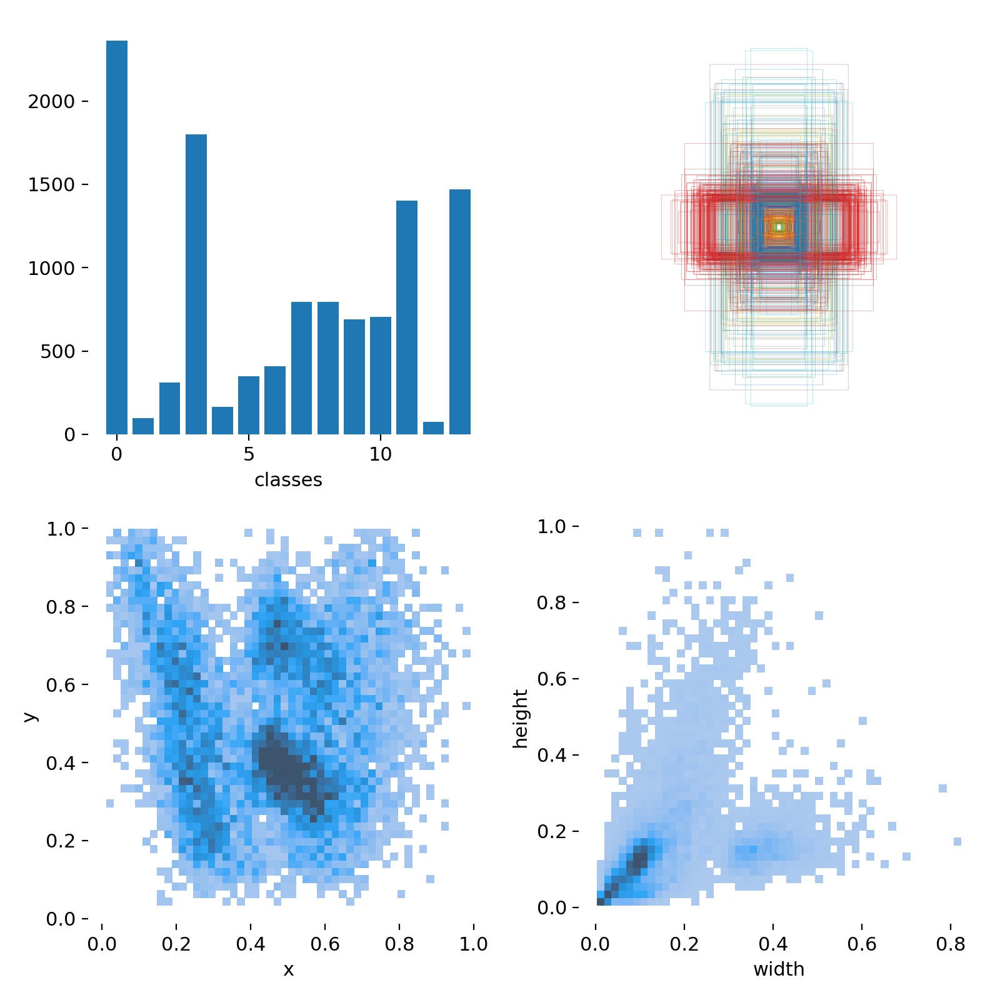

In [14]:
Image(filename="runs/train/exp/labels.jpg", width=600)

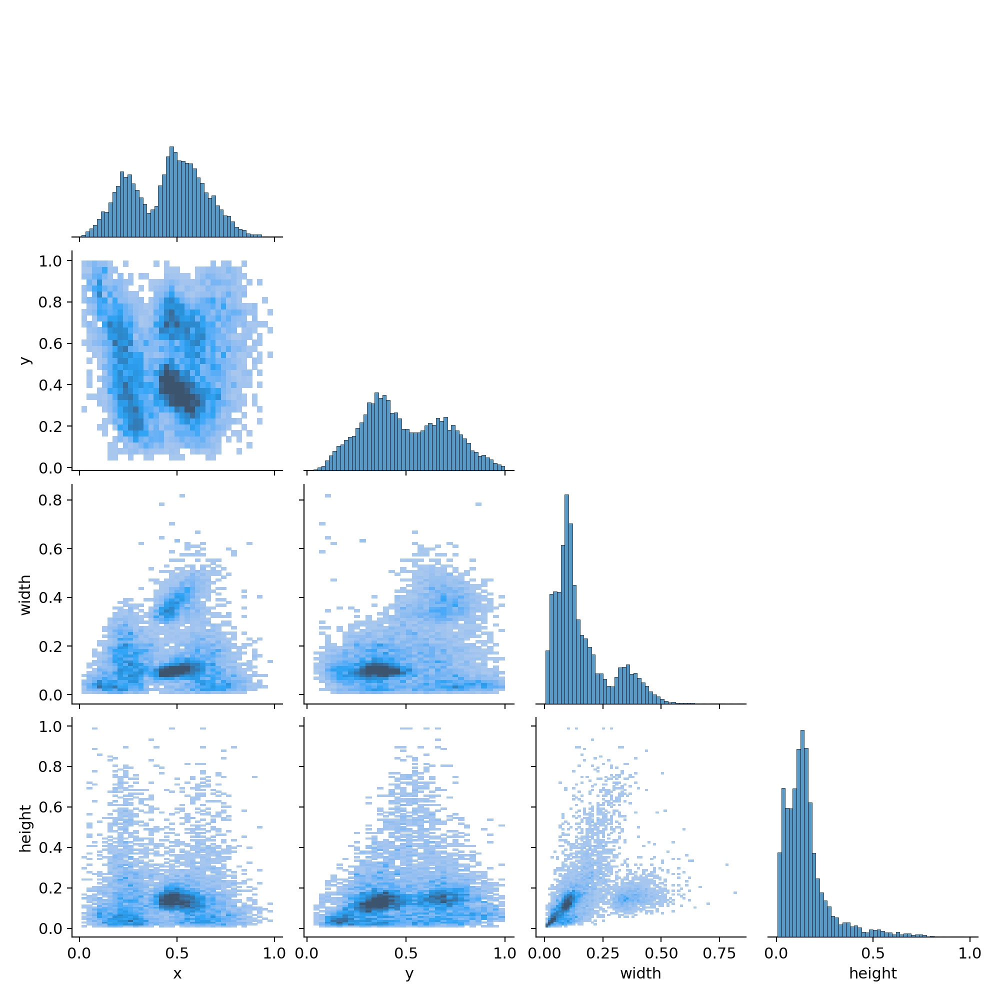

In [15]:
Image(filename="runs/train/exp/labels_correlogram.jpg", width=800)

### Train results

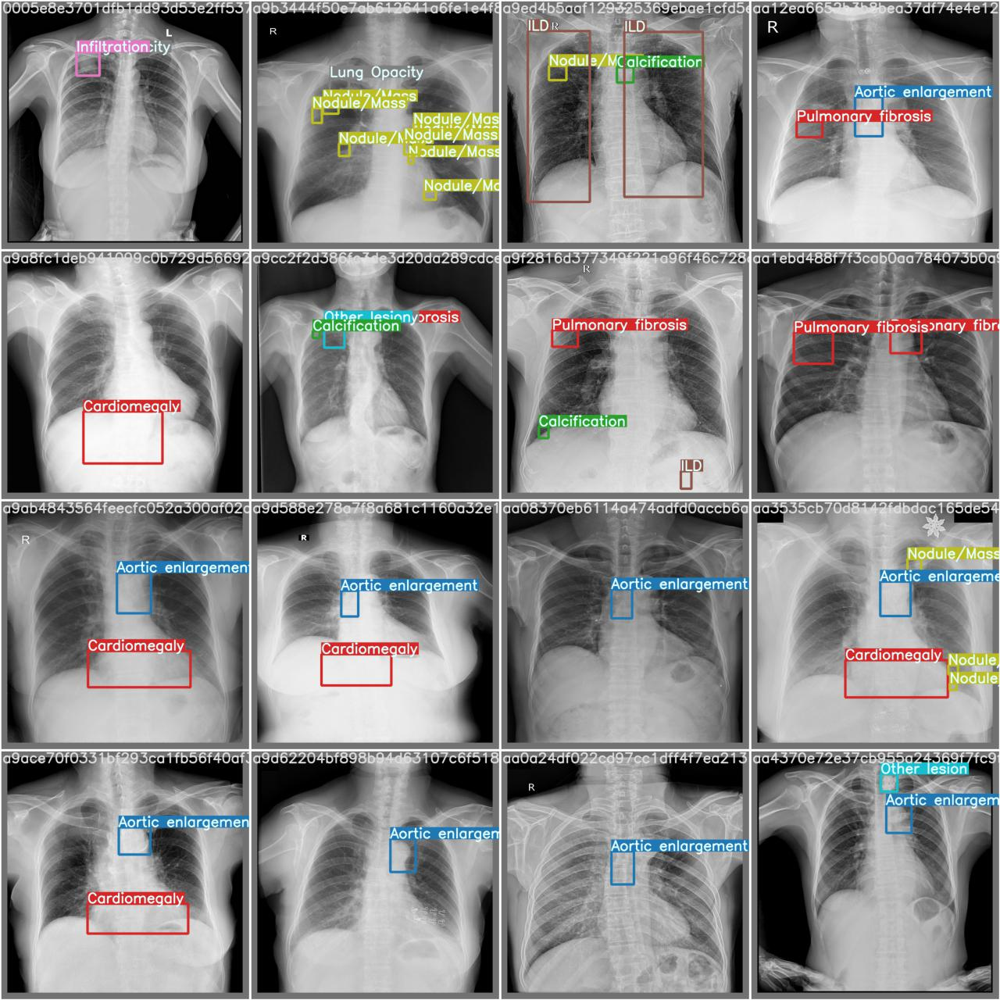

In [16]:
Image(filename="runs/train/exp/test_batch0_labels.jpg", width=800)

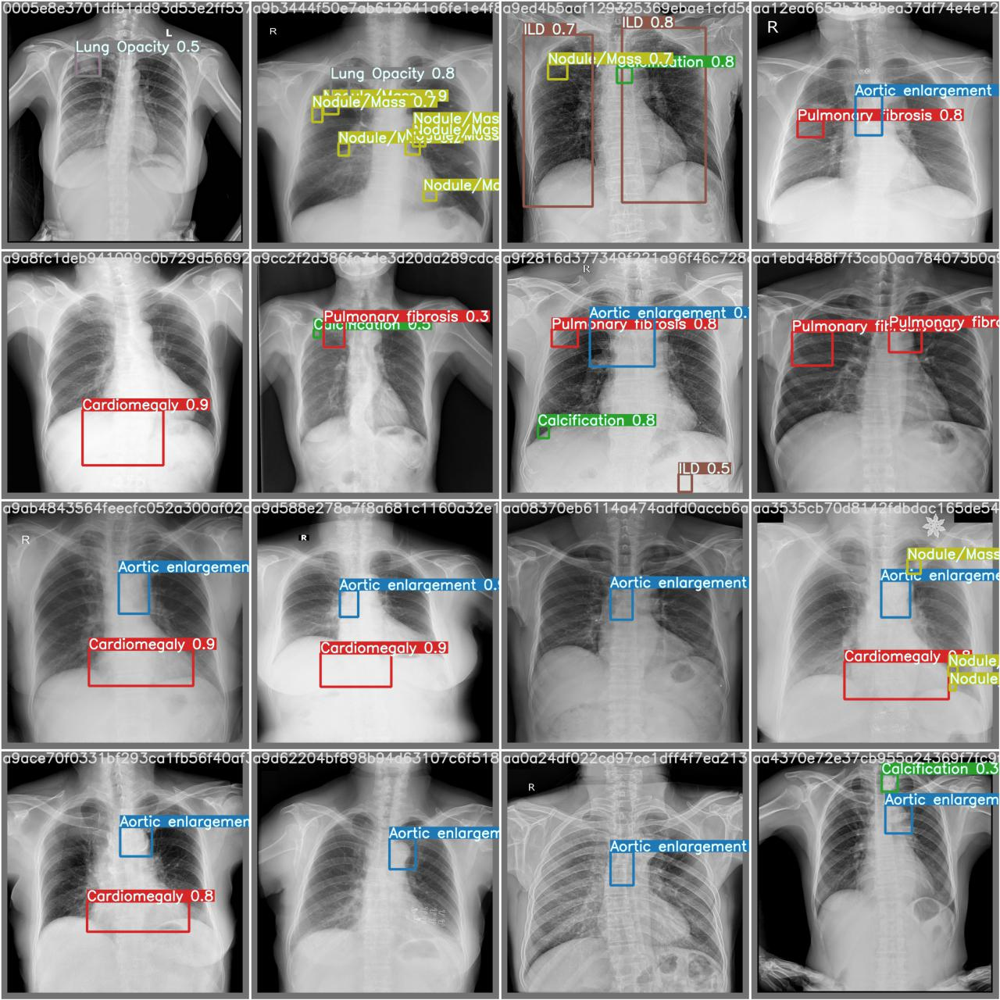

In [17]:
Image(filename="runs/train/exp/test_batch0_pred.jpg", width=800)

### Learning curves

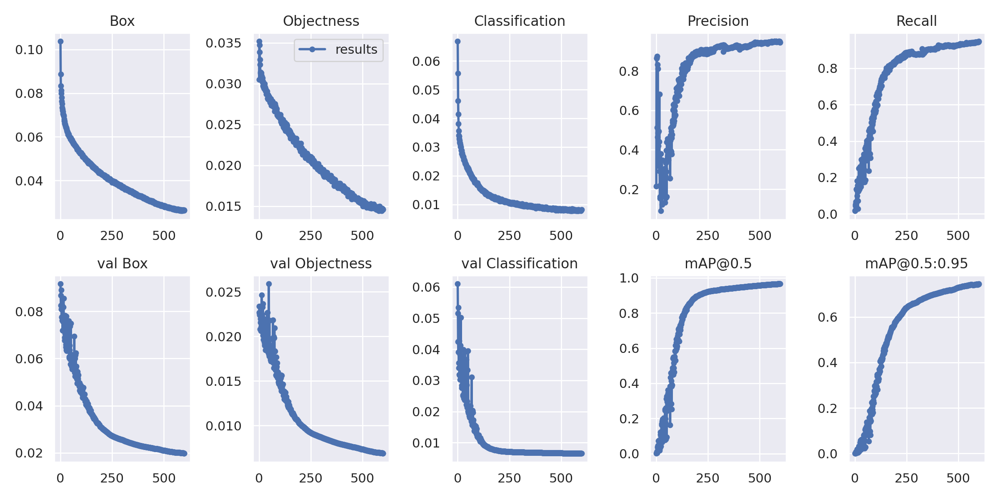

In [18]:
Image(filename="runs/train/exp/results.png", width=1200)

F1 curve

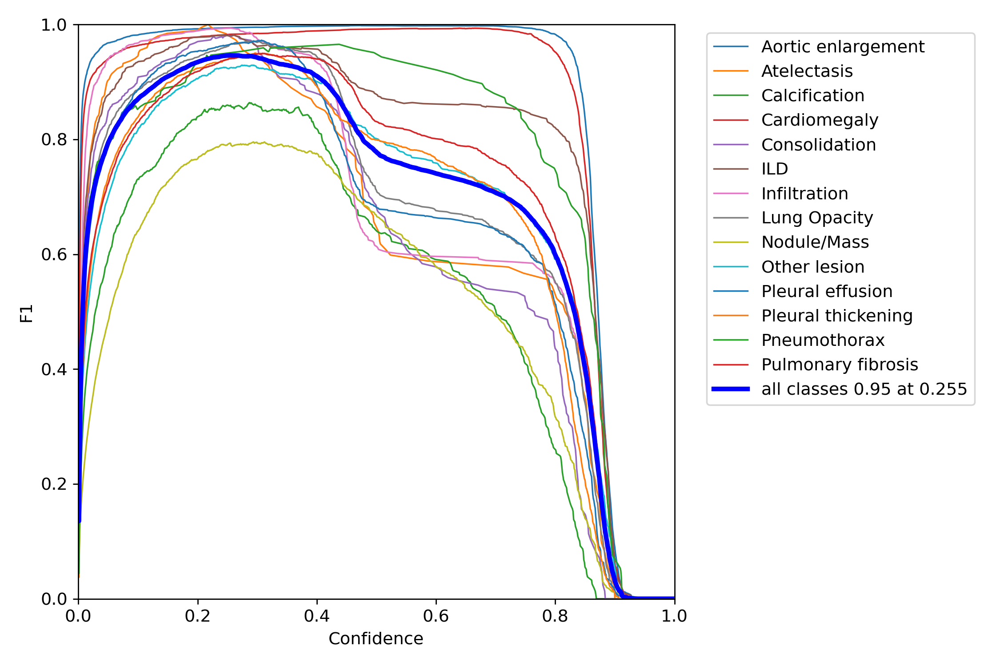

In [19]:
Image(filename="runs/train/exp/F1_curve.png", width=800)

PR curve

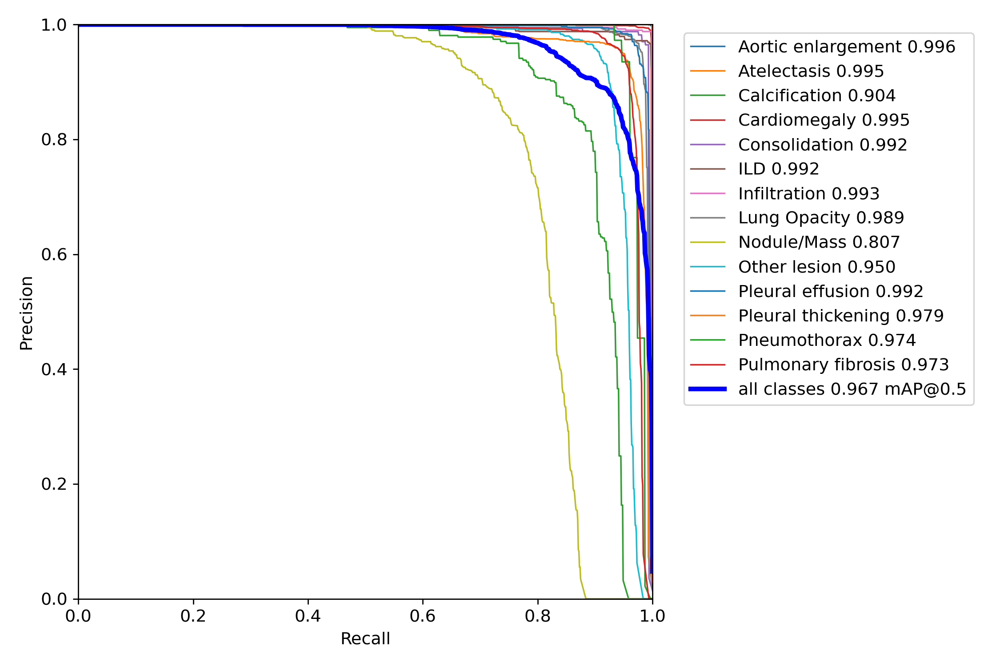

In [20]:
Image(filename="runs/train/exp/PR_curve.png", width=800)

### Confusion matrix

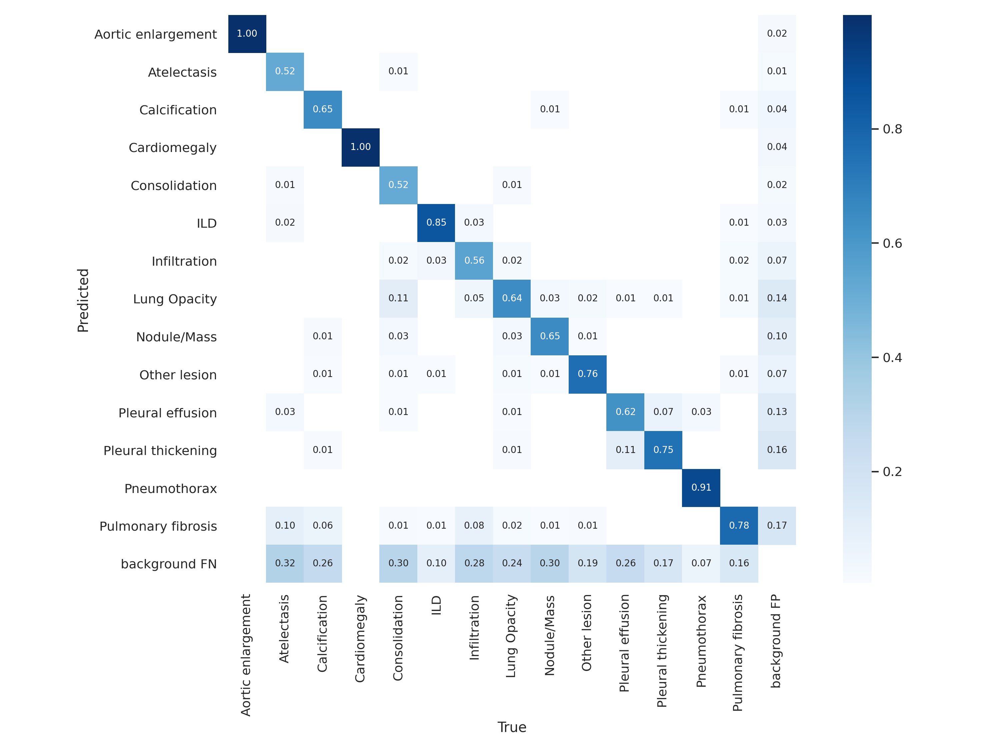

In [21]:
Image(filename="runs/train/exp/confusion_matrix.png", width=800)

## Run predictions

In [22]:
# Use --agnostic-nms to run class-agnostic NMS?
# Use --augment for TTA?
!python detect.py --weights "runs/train/exp/weights/best.pt" --img {IMAGE_SIZE} --conf-thres 0.3 --iou-thres 0.5 --source {INPUT_FOLDER}/vbdyolo/vbdyolo/images/test --save-txt --save-conf

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.3, device='', exist_ok=False, img_size=512, iou_thres=0.5, name='exp', project='runs/detect', save_conf=True, save_txt=True, source='/kaggle/input/vbdyolo/vbdyolo/images/test', update=False, view_img=False, weights=['runs/train/exp/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.8.0+cu101 CUDA:0 (Tesla V100-SXM2-16GB, 16160.5MB)

Fusing layers... 
Model Summary: 224 layers, 7088971 parameters, 0 gradients, 16.4 GFLOPS
image 1/3001 /kaggle/input/vbdyolo/vbdyolo/images/test/002a34c58c5b758217ed1f584ccbcfe9.png: 512x512 1 Cardiomegaly, Done. (0.008s)
image 2/3001 /kaggle/input/vbdyolo/vbdyolo/images/test/004f33259ee4aef671c2b95d54e4be68.png: 512x512 1 Aortic enlargement, Done. (0.008s)
image 3/3001 /kaggle/input/vbdyolo/vbdyolo/images/test/008bdde2af2462e86fd373a445d0f4cd.png: 512x512 1 Aortic enlargement, 1 Cardiomegaly, Done. (0.008s)
image 4/3001 /kaggle/input/vbdyolo/vbdyolo/images/test/009bc039326338823ca3aa8

## Collect predictions

In [23]:
!ls runs/detect/exp/labels/ | wc -l

1513


In [24]:
!mkdir -p {OUTPUT_FOLDER}/vbdyolo_out/labels_pred/
!cp -r runs/detect/exp/labels/*.txt {OUTPUT_FOLDER}/vbdyolo_out/labels_pred/